In [1]:
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter
import numpy as np
import json
import os


In [34]:

plot_title = "plummer_barnes_hut_n_vs_time_th0.2_1"
data_title = f"./Scaling/RTX3070/{plot_title}.json"
data_dict = json.loads(open(data_title).read())
n_pows = data_dict['n_pows']
token_arrays = data_dict['token_arrays']

In [36]:
use_keys = ["Sorting", "Data-reordering", "Tree-construction", "Grav:", "Build:", "TOTAL:"]
            #Sorting, Moving, Construction, Traverse
use_arrays =  {key: token_arrays[key] for key in use_keys}

[100, 1000, 10000, 100000, 1000000, 10000000]


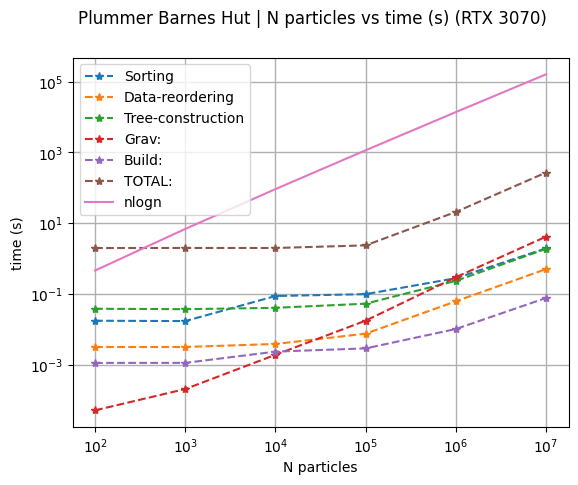

In [37]:
%matplotlib inline

x = []
for n in n_pows:
    x.append(10**n)
print(x)

fig, ax = plt.subplots()
fig.suptitle('Plummer Barnes Hut | N particles vs time (s) (RTX 3070)', fontsize=12)
ax.set_xlabel("N particles")
ax.set_ylabel("time (s)")

ax.grid(linestyle='-', linewidth=1)
ax.set_yscale('log')
# for axis in [ax.xaxis, ax.yaxis]:
#     axis.set_major_formatter(ScalarFormatter())
ax.set_xscale('symlog')

for tokens in use_arrays:
    ax.plot(x, token_arrays[tokens],label=tokens, marker ='*',linestyle='dashed')

y = (x * np.log(x)) / 10**3
ax.plot(x, y,label="nlogn")

ax.legend(loc="upper left")
plt.show()


counter = 0
filename = plot_title + "_{}.png"
while os.path.isfile(filename.format(counter)):
    counter += 1
filename = plot_title + "_{}"
plot_title_final = filename.format(counter)

fig.savefig(plot_title_final +'.svg',format="svg",dpi=1200)
plt.close()

In [16]:
import json
thetas = [0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]
times = []
times2 = []

for th in thetas:
    plot_title = f"plummer_barnes_hut_n_vs_time_th{th}_0"
    data_title = f"./Scaling/GTX1060/{plot_title}.json"
    data_dict = json.loads(open(data_title).rSead())
    n_pows = data_dict['n_pows']
    token_arrays = data_dict['token_arrays']
    # print(data_dict)
    times.append(token_arrays["TOTAL:"][-1])

print(times)

for th in thetas:
    plot_title = f"plummer_barnes_hut_n_vs_time_th{th}_1"
    data_title = f"./Scaling/RTX3070/{plot_title}.json"
    data_dict = json.loads(open(data_title).read())
    n_pows = data_dict['n_pows']
    token_arrays = data_dict['token_arrays']
    # print(data_dict)
    times2.append(token_arrays["TOTAL:"][-1])

print(times2)

[799.018, 317.317, 174.183, 120.092, 91.6917, 73.5027, 65.7697]
[270.784, 110.255, 60.5496, 43.0001, 33.6079, 27.3546, 24.7336]


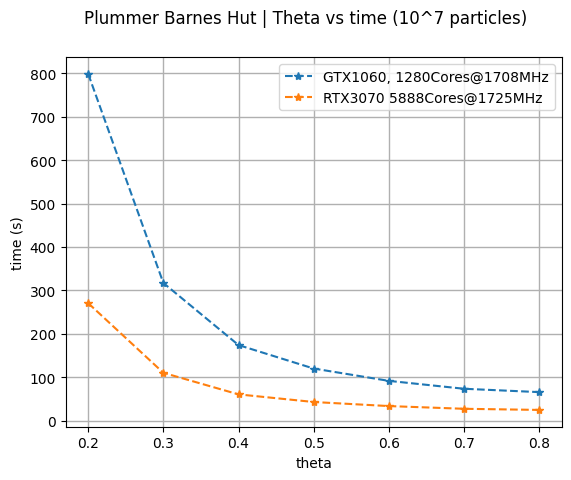

In [24]:
%matplotlib inline

x = thetas
# for n in n_pows:
#     x.append(10**n)
# print(x)

fig, ax = plt.subplots()
fig.suptitle('Plummer Barnes Hut | Theta vs time (10^7 particles)', fontsize=12)
ax.set_xlabel("theta")
ax.set_ylabel("time (s)")

ax.grid(linestyle='-', linewidth=1)
# ax.set_yscale('log')
# for axis in [ax.xaxis, ax.yaxis]:
#     axis.set_major_formatter(ScalarFormatter())
# ax.set_xscale('symlog')

ax.plot(x, times,label="GTX1060, 1280Cores@1708MHz", marker ='*',linestyle='dashed')
ax.plot(x, times2,label="RTX3070, 5888Cores@1725MHz", marker ='*',linestyle='dashed')

# for tokens in use_arrays:
#     ax.plot(x, token_arrays[tokens],label=tokens, marker ='*',linestyle='dashed')

# y = (x * np.log(x)) / 10**3
# ax.plot(x, y,label="nlogn")

ax.legend(loc="upper right")
plt.show()


counter = 0
filename = plot_title + "_{}.png"
while os.path.isfile(filename.format(counter)):
    counter += 1
filename = plot_title + "_{}"
plot_title_final = filename.format(counter)

fig.savefig(plot_title_final +'.svg',format="svg",dpi=1200)
plt.close()

In [1]:
# import pycuda.driver as cuda
# import pycuda.autoinit

# def get_gpu_info():
#     cuda.init()
#     gpu_count = cuda.Device.count()
#     gpu_info = []

#     for i in range(gpu_count):
#         device = cuda.Device(i)
#         attrs = device.get_attributes()

#         # Extracting relevant information
#         info = {
#             "Name": device.name(),
#             "Compute Capability": f"{device.compute_capability()[0]}.{device.compute_capability()[1]}",
#             "Total Memory (MB)": device.total_memory() // (1024 * 1024),
#             "Multiprocessors (SMs)": attrs[cuda.device_attribute.MULTIPROCESSOR_COUNT],
#             "Max Threads Per SM": attrs[cuda.device_attribute.MAX_THREADS_PER_MULTIPROCESSOR],
#             "Total Cores": (attrs[cuda.device_attribute.MULTIPROCESSOR_COUNT] *
#                             128),  # Approximation based on NVIDIA GPU architecture
#             "Warp Size": attrs[cuda.device_attribute.WARP_SIZE],
#             "Max Threads Per Block": attrs[cuda.device_attribute.MAX_THREADS_PER_BLOCK],
#             "L1 Cache Size (KB)": attrs[cuda.device_attribute.MAX_SHARED_MEMORY_PER_MULTIPROCESSOR] // 1024,
#             "L2 Cache Size (KB)": attrs[cuda.device_attribute.L2_CACHE_SIZE] // 1024,
#             "Memory Bus Width (bits)": attrs[cuda.device_attribute.GLOBAL_MEMORY_BUS_WIDTH],
#             "Memory Bandwidth (GB/s)": (attrs[cuda.device_attribute.GLOBAL_MEMORY_BUS_WIDTH] *
#                                         attrs[cuda.device_attribute.MEMORY_CLOCK_RATE] * 2 // (8 * 1000 * 1000)),
#             "Clock Rate (MHz)": attrs[cuda.device_attribute.CLOCK_RATE] // 1000
#         }
        
#         gpu_info.append(info)

#     return gpu_info

# gpu_info = get_gpu_info()

# # Print the information
# for idx, info in enumerate(gpu_info):
#     print(f"GPU {idx}:")
#     for key, value in info.items():
#         print(f"  {key}: {value}")
#     print("\n")

GPU 0:
  Name: NVIDIA GeForce GTX 1060 6GB
  Compute Capability: 6.1
  Total Memory (MB): 6064
  Multiprocessors (SMs): 10
  Max Threads Per SM: 2048
  Total Cores: 1280
  Warp Size: 32
  Max Threads Per Block: 1024
  L1 Cache Size (KB): 96
  L2 Cache Size (KB): 1536
  Memory Bus Width (bits): 192
  Memory Bandwidth (GB/s): 192
  Clock Rate (MHz): 1771




## gpu data

In [1]:
import pycuda.driver as cuda
import pycuda.autoinit
import json

def get_gpu_info():
    cuda.init()
    gpu_count = cuda.Device.count()
    gpu_info = []

    for i in range(gpu_count):
        device = cuda.Device(i)
        attrs = device.get_attributes()

        # Calculating additional values
        total_multiprocessors = attrs[cuda.device_attribute.MULTIPROCESSOR_COUNT]
        warp_size = attrs[cuda.device_attribute.WARP_SIZE]
        max_threads_per_multiprocessor = attrs[cuda.device_attribute.MAX_THREADS_PER_MULTIPROCESSOR]
        clock_rate_mhz = attrs[cuda.device_attribute.CLOCK_RATE] // 1000
        memory_bus_width = attrs[cuda.device_attribute.GLOBAL_MEMORY_BUS_WIDTH]
        memory_clock_rate = attrs[cuda.device_attribute.MEMORY_CLOCK_RATE]  # in KHz

        # Memory Bandwidth in GB/s
        memory_bandwidth_gb_s = (memory_bus_width * memory_clock_rate * 2) // (8 * 1000 * 1000)

        # FLOP calculations (assuming for example: 128 cores per SM, adjust based on architecture)
        half_precision_flops = total_multiprocessors * 64 * 2 * clock_rate_mhz * 10**6
        single_precision_flops = total_multiprocessors * 64 * clock_rate_mhz * 10**6
        double_precision_flops = total_multiprocessors * 64 * clock_rate_mhz * 10**6  # Assumption: 64 double-precision cores per SM
        
        # Extracting and calculating relevant information
        info = {
            "Name": device.name(),
            "Compute Capability": f"{device.compute_capability()[0]}.{device.compute_capability()[1]}",
            "Total Memory (MB)": device.total_memory() // (1024 * 1024),
            "Multiprocessors (SMs)": total_multiprocessors,
            "Max Threads Per SM": max_threads_per_multiprocessor,
            "Total Cores": total_multiprocessors * 128,  # Approximation based on NVIDIA architecture
            "Warp Size": warp_size,
            "Max Threads Per Block": attrs[cuda.device_attribute.MAX_THREADS_PER_BLOCK],
            "Max Blocks Per SM": attrs[cuda.device_attribute.MAX_BLOCKS_PER_MULTIPROCESSOR],
            "Shared Memory Per Block (KB)": attrs[cuda.device_attribute.MAX_SHARED_MEMORY_PER_BLOCK] // 1024,
            "Shared Memory Per SM (KB)": attrs[cuda.device_attribute.MAX_SHARED_MEMORY_PER_MULTIPROCESSOR] // 1024,
            "Registers Per Block": attrs[cuda.device_attribute.MAX_REGISTERS_PER_BLOCK],
            "Registers Per SM": attrs[cuda.device_attribute.MAX_REGISTERS_PER_MULTIPROCESSOR],
            "L1 Cache Size (KB)": attrs[cuda.device_attribute.MAX_SHARED_MEMORY_PER_MULTIPROCESSOR] // 1024,
            "L2 Cache Size (KB)": attrs[cuda.device_attribute.L2_CACHE_SIZE] // 1024,
            "Memory Bus Width (bits)": memory_bus_width,
            "Memory Bandwidth (GB/s)": memory_bandwidth_gb_s,
            "Clock Rate (MHz)": clock_rate_mhz,
            "Warps Per SM": max_threads_per_multiprocessor // warp_size,
            "Blocks Per SM": attrs[cuda.device_attribute.MAX_BLOCKS_PER_MULTIPROCESSOR],
            "Half Precision FLOP/s": half_precision_flops // (1024 * 1024 * 1024 ),
            "Single Precision FLOP/s": single_precision_flops // (1024 * 1024 * 1024),
            "Double Precision FLOP/s": double_precision_flops // (1024 * 1024 * 1024),
            "Concurrent Kernels": attrs[cuda.device_attribute.CONCURRENT_KERNELS],
            "Threads Per Warp": warp_size,
            "Global Memory Bandwidth (GB/s)": memory_bandwidth_gb_s,
            "Global Memory Size (MB)": device.total_memory() // (1024 * 1024),
            "L2 Cache Size": attrs[cuda.device_attribute.L2_CACHE_SIZE] // 1024,
            "Memcpy Engines": attrs[cuda.device_attribute.ASYNC_ENGINE_COUNT]
        }
        
        gpu_info.append(info)

    return gpu_info

def save_gpu_info_to_json(folder_path, filename='gpu_info.json'):
    gpu_info = get_gpu_info()

    # Construct the full file path
    file_path = os.path.join(folder_path, filename)
    
    # Saving the information to the JSON file
    with open(file_path, 'w') as json_file:
        json.dump(gpu_info, json_file, indent=4)

    print(f"GPU info saved to {file_path}")

# # Print the information
# for idx, info in enumerate(gpu_info):
#     print(f"GPU {idx}:")
#     for key, value in info.items():
#         print(f"  {key}: {value}")
#     print("\n")


In [2]:
import subprocess
import re
from IPython.display import clear_output, display
import resource

# _N = 100000
# _theta = 0.2
# _I = 2
# _dt = 0.0625 * 1000000
# _samples = 10

def exec_sim(_N = 100000,_theta = 0.2,_I = 2,_dt = 0.0625,_samples = 10):
    resource.setrlimit(resource.RLIMIT_STACK, (resource.RLIM_INFINITY, resource.RLIM_INFINITY))
    true_t = []
    t_sims = []

    command = [
        "../Bonsai-master/runtime/bonsai2_slowdust", 
        "--plummer", f"{_N}", 
        "--snapname", "temp/plummer_gen_template", 
        "--snapiter", "0.0625/1", 
        "-I", "0", 
        "--eps", "0.05", 
        "--theta", "0.8"
    ]
    output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)
    
    for i in range(_samples):

        # Command to run
        command = [
            "../Bonsai-master/runtime/bonsai2_slowdust", 
            "--infile", "temp/plummer_gen_template_00000.0000-0", 
            "--snapname", "data/plummer_snap_mpi", 
            "--snapiter", "0", 
            "--eps", "0.05", 
            "--theta", f"{_theta}"
            ,"-T", "100000000" 
            ,"-I", f"{_I}" 
            ,"--dt", f"{_dt}" 
        ]

        # Initialize list to store differences between consecutive t_sim values
        t_sim_diff_list = []
        iter_list = []

        # Regular expressions to capture t_sim and iteration number
        t_sim_pattern = re.compile(r't_sim=\s+([\d.eE+-]+)\s+sec')
        iter_pattern = re.compile(r'iter=(\d+)')

        # Variables to store the previous t_sim and iter values
        prev_t_sim = None
        prev_iter = -1

        # Run the command and capture the output (both stdout and stderr)
        print(f"{i}: ", " ".join(command))
        output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)

        # Clean up control characters like carriage return
        # This will ensure that only the latest instance of any overwritten lines is kept
        clean_output = output.replace('\r', '\n')

        # Process the cleaned output line by line
        for line in clean_output.splitlines():
            # clear_output(wait=True)
            # display(str(line))
            # print(line)

            # Extract iter value
            iter_match = iter_pattern.search(line)
            if iter_match:
                iter = int(iter_match.group(1))
                if iter - prev_iter != 1:
                    continue
                iter_list.append(iter)
                prev_iter = iter

            # Extract t_sim value
            t_sim_match = t_sim_pattern.search(line)
            if t_sim_match:
                current_t_sim = float(t_sim_match.group(1))
                
                # If there's a previous t_sim, calculate the difference
                if prev_t_sim is not None:
                    t_sim_diff_list.append(current_t_sim - prev_t_sim)
                
                # Update previous t_sim value
                prev_t_sim = current_t_sim

        # Calculate and display statistics if list is not empty
        if t_sim_diff_list:
            t_sim_diff_avg = sum(t_sim_diff_list[1:]) / len(t_sim_diff_list[1:])

        true_t.append(t_sim_diff_avg)
        t_sims.append(prev_t_sim)

    # print(true_t)
    if true_t:
        true_t_min = min(true_t)
        true_t_max = max(true_t)
        true_t_avg = sum(true_t) / len(true_t)

        print(f"Min true_t: {true_t_min} sec")
        print(f"Max true_t: {true_t_max} sec")
        print(f"Average true_t: {true_t_avg} sec")

        return true_t_min,true_t_max,true_t_avg
        # print([x/(true_t_avg * prev_iter) for x in t_sims])

def profile_sim(_N = 100000,_theta = 0.2,_I = 2,_dt = 0.0625):
    resource.setrlimit(resource.RLIMIT_STACK, (resource.RLIM_INFINITY, resource.RLIM_INFINITY))
    csv_out = None

    command = [
        "../Bonsai-master/runtime/bonsai2_slowdust", 
        "--plummer", f"{_N}", 
        "--snapname", "temp/plummer_gen_template", 
        "--snapiter", "0.0625/1", 
        "-I", "0", 
        "--eps", "0.05", 
        "--theta", "0.8"
    ]
    output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)
    
    for kernel in ["dev_approximate_gravity","correct_particles","cl_build_key_list","compute_leaf","predict_particles"]:
        command = [
            "nvprof", "-f", "--print-gpu-trace", "--csv",
            "--kernels", f"::{kernel}:2", "--metrics", "inst_per_warp,branch_efficiency,warp_execution_efficiency,warp_nonpred_execution_efficiency,inst_replay_overhead,shared_load_transactions_per_request,shared_store_transactions_per_request,local_load_transactions_per_request,local_store_transactions_per_request,gld_transactions_per_request,gst_transactions_per_request,shared_store_transactions,shared_load_transactions,local_load_transactions,local_store_transactions,gld_transactions,gst_transactions,sysmem_read_transactions,sysmem_write_transactions,l2_read_transactions,l2_write_transactions,global_hit_rate,local_hit_rate,gld_requested_throughput,gst_requested_throughput,gld_throughput,gst_throughput,local_memory_overhead,tex_cache_hit_rate,l2_tex_read_hit_rate,l2_tex_write_hit_rate,tex_cache_throughput,l2_tex_read_throughput,l2_tex_write_throughput,l2_read_throughput,l2_write_throughput,sysmem_read_throughput,sysmem_write_throughput,local_load_throughput,local_store_throughput,shared_load_throughput,shared_store_throughput,gld_efficiency,gst_efficiency,tex_cache_transactions,flop_count_dp,flop_count_dp_add,flop_count_dp_fma,flop_count_dp_mul,inst_issued,sysmem_utilization,stall_inst_fetch,stall_exec_dependency,stall_memory_dependency,stall_texture,stall_sync,stall_other,stall_constant_memory_dependency,stall_pipe_busy,shared_efficiency,inst_fp_64,inst_bit_convert,inst_control,inst_compute_ld_st,inst_misc,issue_slots,cf_issued,cf_executed,ldst_issued,ldst_executed,atomic_transactions,atomic_transactions_per_request,l2_atomic_throughput,l2_atomic_transactions,l2_tex_read_transactions,stall_memory_throttle,stall_not_selected,l2_tex_write_transactions,flop_count_hp,flop_count_hp_add,flop_count_hp_mul,flop_count_hp_fma,inst_fp_16,sysmem_read_utilization,sysmem_write_utilization,pcie_total_data_transmitted,pcie_total_data_received,inst_executed_global_loads,inst_executed_local_loads,inst_executed_shared_loads,inst_executed_surface_loads,inst_executed_global_stores,inst_executed_local_stores,inst_executed_shared_stores,inst_executed_surface_stores,inst_executed_global_atomics,inst_executed_global_reductions,inst_executed_surface_atomics,inst_executed_surface_reductions,inst_executed_shared_atomics,inst_executed_tex_ops,l2_global_load_bytes,l2_local_load_bytes,l2_surface_load_bytes,l2_local_global_store_bytes,l2_global_reduction_bytes,l2_global_atomic_store_bytes,l2_surface_store_bytes,l2_surface_reduction_bytes,l2_surface_atomic_store_bytes,global_load_requests,local_load_requests,surface_load_requests,global_store_requests,local_store_requests,surface_store_requests,global_atomic_requests,global_reduction_requests,surface_atomic_requests,surface_reduction_requests,sysmem_read_bytes,sysmem_write_bytes,l2_tex_hit_rate,texture_load_requests,unique_warps_launched,sm_efficiency,achieved_occupancy,ipc,issued_ipc,issue_slot_utilization,eligible_warps_per_cycle,tex_utilization,l2_utilization,shared_utilization,ldst_fu_utilization,cf_fu_utilization,special_fu_utilization,tex_fu_utilization,single_precision_fu_utilization,double_precision_fu_utilization,dram_read_transactions,dram_write_transactions,dram_read_throughput,dram_write_throughput,dram_utilization,half_precision_fu_utilization,ecc_transactions,ecc_throughput,dram_read_bytes,dram_write_bytes", "--events", "all", 
            "../Bonsai-master/runtime/bonsai2_slowdust", 
            "--infile", "temp/plummer_gen_template_00000.0000-0", 
            "--snapiter", "0", 
            "--eps", "0.05", 
            "--theta", f"{_theta}"
            ,"-T", "100000000" 
            ,"-I", f"{_I}" 
            ,"--dt", f"{_dt}" 
        ]

        print(f"{kernel}: ", " ".join(command))
        output = subprocess.check_output(command, stderr=subprocess.STDOUT, text=True)
    
        # Clean up control characters like carriage return
        # This will ensure that only the latest instance of any overwritten lines is kept
        clean_output = output.replace('\r', '\n')

        # Process the cleaned output line by line
        start_read = False
        exec = []
        for line in clean_output.splitlines():
            # clear_output(wait=True)
            # display(str(line))
            # print(line)

            if "Profiling result" in line:
                start_read = True
                continue

            if not start_read:
                continue

            exec.append(line)
        if not csv_out:
            csv_out = exec[0] + "\n" + exec[1] + "\n"
        
        csv_out += exec[-1] + "\n"

    return csv_out
    # file_name = "test.csv"
    # with open(file_name, 'w') as x_file:
    #     x_file.write(csv_out)

def profile_sim_ncu(_N = 100000,_theta = 0.2,_I = 2,_dt = 0.0625):
    resource.setrlimit(resource.RLIMIT_STACK, (resource.RLIM_INFINITY, resource.RLIM_INFINITY))
    csv_out = None

    command = [
        "../Bonsai-master/runtime/bonsai2_slowdust", 
        "--plummer", f"{_N}", 
        "--snapname", "temp/plummer_gen_template", 
        "--snapiter", "0.0625/1", 
        "-I", "0", 
        "--eps", "0.05", 
        "--theta", "0.8"
    ]
    output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)
    
    for kernel in ["dev_approximate_gravity","correct_particles","cl_build_key_list","compute_leaf","predict_particles"]:
        command = [
            "/opt/nvidia/nsight-compute/2023.1.1/ncu", "--kernel-id", f"::{kernel}:2",
            # "--csv",
            # "--set", "detailed",
            "--csv", # "--page", "raw",
            "--metrics", "sm__warps_active.avg.pct_of_peak_sustained_active,l1tex__t_set_accesses_pipe_lsu_mem_global_op_atom.sum,l1tex__t_set_accesses_pipe_lsu_mem_global_op_red.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_atom.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_red.sum,l1tex__t_requests_pipe_lsu_mem_global_op_atom.sum,l1tex__t_requests_pipe_lsu_mem_global_op_red.sum,smsp__sass_average_branch_targets_threads_uniform.pct,smsp__inst_executed_pipe_cbu.sum,smsp__inst_executed_pipe_adu.sum,smsp__inst_executed_pipe_fp64.avg.pct_of_peak_sustained_active,dram__bytes_read.sum,dram__bytes_read.sum.per_second,dram__sectors_read.sum,dram__throughput.avg.pct_of_peak_sustained_elapsed,dram__bytes_write.sum,dram__bytes_write.sum.per_second,dram__sectors_write.sum,smsp__warps_eligible.sum.per_cycle_active,smsp__sass_thread_inst_executed_op_dadd_pred_on.sum,smsp__sass_thread_inst_executed_op_dmul_pred_on.sum,smsp__sass_thread_inst_executed_op_dfma_pred_on.sum,smsp__sass_thread_inst_executed_op_dadd_pred_on.sum,smsp__sass_thread_inst_executed_op_dfma_pred_on.sum,smsp__sass_thread_inst_executed_op_dmul_pred_on.sum,smsp__sass_thread_inst_executed_op_hadd_pred_on.sum,smsp__sass_thread_inst_executed_op_hmul_pred_on.sum,smsp__sass_thread_inst_executed_op_hfma_pred_on.sum,smsp__sass_thread_inst_executed_op_hadd_pred_on.sum,smsp__sass_thread_inst_executed_op_hfma_pred_on.sum,smsp__sass_thread_inst_executed_op_hmul_pred_on.sum,smsp__sass_thread_inst_executed_op_fadd_pred_on.sum,smsp__sass_thread_inst_executed_op_fmul_pred_on.sum,smsp__sass_thread_inst_executed_op_ffma_pred_on.sum,smsp__sass_thread_inst_executed_op_fadd_pred_on.sum,smsp__sass_thread_inst_executed_op_ffma_pred_on.sum,smsp__sass_thread_inst_executed_op_fmul_pred_on.sum,smsp__sass_thread_inst_executed_ops_dadd_dmul_dfma_pred_on.avg.pct_of_peak_sustained_elapsed,smsp__sass_thread_inst_executed_ops_hadd_hmul_hfma_pred_on.avg.pct_of_peak_sustained_elapsed,smsp__sass_thread_inst_executed_ops_fadd_fmul_ffma_pred_on.avg.pct_of_peak_sustained_elapsed,smsp__sass_average_data_bytes_per_sector_mem_global_op_ld.pct,l1tex__t_bytes_pipe_lsu_mem_global_op_ld.sum.per_second,l1tex__t_sectors_pipe_lsu_mem_global_op_ld.sum,l1tex__average_t_sectors_per_request_pipe_lsu_mem_global_op_ld.ratio,l1tex__t_requests_pipe_lsu_mem_global_op_atom.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_ld_lookup_hit.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_st_lookup_hit.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_red_lookup_hit.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_atom_lookup_hit.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_ld.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_st.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_red.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_atom.sum,l1tex__t_requests_pipe_lsu_mem_global_op_ld.sum,l1tex__t_requests_pipe_lsu_mem_global_op_red.sum,l1tex__t_requests_pipe_lsu_mem_global_op_st.sum,smsp__sass_average_data_bytes_per_sector_mem_global_op_st.pct,l1tex__t_bytes_pipe_lsu_mem_global_op_st.sum.per_second,l1tex__t_sectors_pipe_lsu_mem_global_op_st.sum,l1tex__average_t_sectors_per_request_pipe_lsu_mem_global_op_st.ratio,smsp__inst_executed_pipe_fp16.avg.pct_of_peak_sustained_active,smsp__sass_thread_inst_executed_op_conversion_pred_on.sum,smsp__sass_thread_inst_executed_op_memory_pred_on.sum,smsp__sass_thread_inst_executed_op_control_pred_on.sum,smsp__inst_executed.sum,smsp__sass_inst_executed_op_global_atom.sum,smsp__inst_executed_op_global_ld.sum,smsp__inst_executed_op_global_red.sum,smsp__inst_executed_op_global_st.sum,smsp__inst_executed_op_local_ld.sum,smsp__inst_executed_op_local_st.sum,smsp__inst_executed_op_shared_atom.sum,smsp__inst_executed_op_shared_atom_dot_alu.sum,smsp__inst_executed_op_shared_atom_dot_cas.sum,smsp__inst_executed_op_shared_ld.sum,smsp__inst_executed_op_shared_st.sum,smsp__inst_executed_op_surface_atom.sum,smsp__inst_executed_op_surface_ld.sum,smsp__inst_executed_op_shared_atom_dot_alu.sum,smsp__inst_executed_op_shared_atom_dot_cas.sum,smsp__inst_executed_op_surface_red.sum,smsp__inst_executed_op_surface_st.sum,smsp__inst_executed_op_texture.sum,smsp__sass_thread_inst_executed_op_fp16_pred_on.sum,smsp__sass_thread_inst_executed_op_fp32_pred_on.sum,smsp__sass_thread_inst_executed_op_fp64_pred_on.sum,smsp__sass_thread_inst_executed_op_integer_pred_on.sum,smsp__sass_thread_inst_executed_op_inter_thread_communication_pred_on.sum,smsp__inst_issued.sum,smsp__sass_thread_inst_executed_op_misc_pred_on.sum,smsp__average_inst_executed_per_warp.ratio,smsp__inst_executed.avg.per_cycle_active,smsp__issue_active.avg.pct_of_peak_sustained_active,smsp__inst_issued.sum,smsp__inst_issued.avg.per_cycle_active,lts__t_sectors_op_atom.sum.per_second,lts__t_sectors_op_red.sum.per_second,lts__t_sectors_op_atom.sum,lts__t_sectors_op_red.sum,lts__t_bytes_equiv_l1sectormiss_pipe_lsu_mem_global_op_atom.sum,lts__t_bytes_equiv_l1sectormiss_pipe_lsu_mem_global_op_ld.sum,lts__t_bytes_equiv_l1sectormiss_pipe_lsu_mem_local_op_st.sum,lts__t_bytes_equiv_l1sectormiss_pipe_lsu_mem_global_op_st.sum,lts__t_bytes_equiv_l1sectormiss_pipe_lsu_mem_local_op_ld.sum,lts__t_sectors_op_read.sum.per_second,lts__t_sectors_op_atom.sum.per_second,lts__t_sectors_op_red.sum.per_second,lts__t_sectors_op_read.sum,lts__t_sectors_op_atom.sum,lts__t_sectors_op_red.sum,lts__t_bytes_equiv_l1sectormiss_pipe_tex_mem_surface_op_ld.sum,lts__t_bytes_equiv_l1sectormiss_pipe_tex_mem_surface_op_st.sum,lts__t_sector_hit_rate.pct,lts__t_sector_op_read_hit_rate.pct,lts__t_sectors_srcunit_tex_op_read.sum.per_second,lts__t_sectors_srcunit_tex_op_read.sum,lts__t_sector_op_write_hit_rate.pct,lts__t_sectors_srcunit_tex_op_write.sum.per_second,lts__t_sectors_srcunit_tex_op_write.sum,lts__t_sectors.avg.pct_of_peak_sustained_elapsed,lts__t_sectors_op_write.sum.per_second,lts__t_sectors_op_atom.sum.per_second,lts__t_sectors_op_red.sum.per_second,lts__t_sectors_op_write.sum,lts__t_sectors_op_atom.sum,lts__t_sectors_op_red.sum,smsp__inst_executed_pipe_lsu.avg.pct_of_peak_sustained_active,l1tex__t_requests_pipe_lsu_mem_local_op_ld.sum,l1tex__t_bytes_pipe_lsu_mem_local_op_ld.sum.per_second,l1tex__t_sectors_pipe_lsu_mem_local_op_ld.sum,l1tex__average_t_sectors_per_request_pipe_lsu_mem_local_op_ld.ratio,l1tex__t_requests_pipe_lsu_mem_local_op_st.sum,l1tex__t_sectors_pipe_lsu_mem_local_op_st.sum.per_second,l1tex__t_sectors_pipe_lsu_mem_local_op_st.sum,l1tex__average_t_sectors_per_request_pipe_lsu_mem_local_op_st.ratio,pcie__read_bytes.sum,pcie__write_bytes.sum,smsp__sass_average_data_bytes_per_wavefront_mem_shared.pct,l1tex__data_pipe_lsu_wavefronts_mem_shared_op_ld.sum.per_second,l1tex__data_pipe_lsu_wavefronts_mem_shared_op_ld.sum,l1tex__data_pipe_lsu_wavefronts_mem_shared_op_st.sum.per_second,l1tex__data_pipe_lsu_wavefronts_mem_shared_op_st.sum,l1tex__data_pipe_lsu_wavefronts_mem_shared.avg.pct_of_peak_sustained_elapsed,smsp__pipe_fma_cycles_active.avg.pct_of_peak_sustained_active,smsp__cycles_active.avg.pct_of_peak_sustained_elapsed,l1tex__texin_sm2tex_req_cycles_active.avg.pct_of_peak_sustained_elapsed,smsp__inst_executed_pipe_xu.avg.pct_of_peak_sustained_active,smsp__warp_issue_stalled_imc_miss_per_warp_active.pct,smsp__warp_issue_stalled_short_scoreboard_per_warp_active.pct,smsp__warp_issue_stalled_wait_per_warp_active.pct,smsp__warp_issue_stalled_no_instruction_per_warp_active.pct,smsp__warp_issue_stalled_long_scoreboard_per_warp_active.pct,smsp__warp_issue_stalled_drain_per_warp_active.pct,smsp__warp_issue_stalled_lg_throttle_per_warp_active.pct,smsp__warp_issue_stalled_not_selected_per_warp_active.pct,smsp__warp_issue_stalled_dispatch_stall_per_warp_active.pct,smsp__warp_issue_stalled_misc_per_warp_active.pct,smsp__warp_issue_stalled_math_pipe_throttle_per_warp_active.pct,smsp__warp_issue_stalled_mio_throttle_per_warp_active.pct,smsp__warp_issue_stalled_sleeping_per_warp_active.pct,smsp__warp_issue_stalled_barrier_per_warp_active.pct,smsp__warp_issue_stalled_membar_per_warp_active.pct,smsp__warp_issue_stalled_tex_throttle_per_warp_active.pct,l1tex__t_requests_pipe_tex_mem_surface_op_atom.sum,l1tex__t_requests_pipe_tex_mem_surface_op_ld.sum,l1tex__t_requests_pipe_tex_mem_surface_op_red.sum,l1tex__t_requests_pipe_tex_mem_surface_op_st.sum,lts__t_sectors_aperture_sysmem_op_read,lts__t_sectors_aperture_sysmem_op_read.sum.per_second,lts__t_sectors_aperture_sysmem_op_read.sum,lts__t_sectors_aperture_sysmem_op_write,lts__t_sectors_aperture_sysmem_op_write.sum.per_second,lts__t_sectors_aperture_sysmem_op_write.sum,sm__pipe_tensor_op_hmma_cycles_active.avg.pct_of_peak_sustained_active,sm__pipe_tensor_op_imma_cycles_active.avg.pct_of_peak_sustained_active,l1tex__t_sector_hit_rate.pct,l1tex__lsu_writeback_active.avg.pct_of_peak_sustained_active,l1tex__tex_writeback_active.avg.pct_of_peak_sustained_active,smsp__inst_executed_pipe_tex.avg.pct_of_peak_sustained_active,l1tex__f_tex2sm_cycles_active.avg.pct_of_peak_sustained_elapsed,sm__mio2rf_writeback_active.avg.pct_of_peak_sustained_elapsed,l1tex__t_requests_pipe_tex_mem_texture.sum,smsp__thread_inst_executed_per_inst_executed.ratio,smsp__thread_inst_executed_per_inst_executed.pct,sm__cycles_active.sum,sm__cycles_active.sum,sys__cycles_active.sum,sm__warps_active.sum,sm__warps_active.sum,smsp__inst_executed_op_generic_atom_dot_alu.sum,sm__cycles_elapsed.sum,sm__cycles_elapsed.sum,sys__cycles_elapsed.sum,dram__sectors_read.sum,dram__sectors_read.sum,dram__sectors_write.sum,dram__sectors_write.sum,smsp__inst_executed_op_generic_atom_dot_cas.sum,smsp__inst_executed_op_global_red.sum,sm__inst_executed.sum,smsp__inst_executed_pipe_fma.sum,smsp__inst_executed_pipe_fma.sum,smsp__inst_executed_pipe_fma.sum,smsp__inst_executed_pipe_fma.sum,smsp__inst_executed_pipe_fp16.sum,smsp__inst_executed_pipe_fp16.sum,smsp__inst_executed_pipe_fp16.sum,smsp__inst_executed_pipe_fp16.sum,smsp__inst_executed_pipe_fp64.sum,smsp__inst_executed_pipe_fp64.sum,smsp__inst_executed_pipe_fp64.sum,smsp__inst_executed_pipe_fp64.sum,sm__inst_issued.sum,lts__t_sectors_op_read_lookup_miss.sum,lts__t_sectors_op_read_lookup_miss.sum,lts__t_sectors_aperture_sysmem_op_read.sum,lts__t_sectors_aperture_sysmem_op_read.sum,lts__t_sectors_srcunit_tex_op_read_lookup_hit.sum,lts__t_sectors_srcunit_tex_op_read_lookup_hit.sum,lts__t_sectors_srcunit_tex_op_read.sum,lts__t_sectors_srcunit_tex_op_read.sum,lts__t_sectors_op_read.sum,lts__t_sectors_op_atom.sum,lts__t_sectors_op_red.sumlts__t_sectors_op_read.sum,lts__t_sectors_op_atom.sum,lts__t_sectors_op_red.sumlts__t_sectors_op_write.sum,lts__t_sectors_op_atom.sum,lts__t_sectors_op_red.sumlts__t_sectors_op_write.sum,lts__t_sectors_op_atom.sum,lts__t_sectors_op_red.sumlts__t_sectors_op_write_lookup_miss.sum,lts__t_sectors_op_write_lookup_miss.sum,lts__t_sectors_aperture_sysmem_op_write.sum,lts__t_sectors_aperture_sysmem_op_write.sum,lts__t_sectors_srcunit_tex_op_write_lookup_hit.sum,lts__t_sectors_srcunit_tex_op_write_lookup_hit.sum,lts__t_sectors_srcunit_tex_op_write.sum,lts__t_sectors_srcunit_tex_op_write.sum,smsp__thread_inst_executed_pred_on.sum,smsp__issue_inst0.sum,sm__ctas_launched.sum,smsp__inst_executed_op_shared_ld.sum,smsp__inst_executed_op_shared_st.sum,smsp__inst_executed_op_generic_ld.sum,smsp__inst_executed_op_generic_st.sum,smsp__inst_executed_op_global_ld.sum,smsp__inst_executed_op_global_st.sum,smsp__inst_executed_op_local_ld.sum,smsp__inst_executed_op_local_st.sum,smsp__inst_executed_op_shared_atom.sum,smsp__inst_executed_op_shared_atom_dot_cas.sum,l1tex__data_bank_conflicts_pipe_lsu_mem_shared_op_ld.sum,l1tex__data_bank_conflicts_pipe_lsu_mem_shared_op_st.sum,l1tex__data_pipe_lsu_wavefronts_mem_shared_op_ld.sum,l1tex__data_pipe_lsu_wavefronts_mem_shared_op_st.sum,smsp__pipe_tensor_cycles_active.sum,smsp__pipe_tensor_cycles_active.sum,smsp__pipe_tensor_cycles_active.sum,smsp__pipe_tensor_cycles_active.sum,smsp__thread_inst_executed.sum,smsp__warps_launched.sum",
            # "--section", '"regex:ComputeWorkloadAnalysis|LaunchStats|Occupancy|SpeedOfLight"',
            "../Bonsai-master/runtime/bonsai2_slowdust", 
            "--infile", "temp/plummer_gen_template_00000.0000-0", 
            "--snapiter", "0", 
            "--eps", "0.05", 
            "--theta", f"{_theta}"
            ,"-T", "100000000" 
            ,"-I", f"{_I}" 
            ,"--dt", f"{_dt}" 
        ]

        print(f"{kernel}: ", " ".join(command))
        # output = subprocess.check_output(command, stderr=subprocess.STDOUT, text=True, check=False)
        try:
            output = subprocess.check_output(command, stderr=subprocess.STDOUT, text=True)
        except subprocess.CalledProcessError as e:
            output = str(e.output)
            
        # Clean up control characters like carriage return
        # This will ensure that only the latest instance of any overwritten lines is kept
        clean_output = output.replace('\r', '\n')
        
        # Process the cleaned output line by line
        # start_read = False
        # exec = []
        # for line in clean_output.splitlines():
        #     # clear_output(wait=True)
        #     # display(str(line))
        #     # print(line)

        #     # if "Profiling result" in line:
        #     if '"ID","Process ID"' in line:
        #         print(line)
        #         start_read = True
        #         # continue

        #     if not start_read:
        #         continue

        #     exec.append(line)
        # if not csv_out:
        #     csv_out = exec[0] + "\n" + exec[1] + "\n"
        
        # csv_out += exec[-1] + "\n"

        # Process the cleaned output line by line
        start_read = False
        exec = []
        for line in clean_output.splitlines():
            # clear_output(wait=True)
            # display(str(line))

            if '"ID","Process ID"' in line:
                # print(line)
                start_read = True
                # continue

            if not start_read:
                continue

            exec.append(line)
        if not csv_out:
            csv_out = exec[0] + "\n"
        
        csv_out += "\n".join(exec[1:]) + "\n"
    return csv_out


    # return csv_out
    # file_name = "test.csv"
    # with open(file_name, 'w') as x_file:
    #     x_file.write(csv_out)

def exec_errors(_N = 100000,_theta = 0.2,_I = 2,_dt = 0.0625):
    resource.setrlimit(resource.RLIMIT_STACK, (resource.RLIM_INFINITY, resource.RLIM_INFINITY))

    command = [
        "../Bonsai-master/runtime/bonsai2_slowdust", 
        "--plummer", f"{_N}", 
        "--snapname", "temp/plummer_gen_template", 
        "--snapiter", "0.0625/1", 
        "-I", "0", 
        "--eps", "0.05", 
        "--theta", "0.8"
    ]
    output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)
    
    # Command to run
    command = [
        "../Bonsai-master/runtime/bonsai2_slowdust", 
        "--infile", "temp/plummer_gen_template_00000.0000-0", 
        "--snapname", "data/plummer_snap_mpi", 
        "--snapiter", "0", 
        "--eps", "0.001", 
        "--theta", f"{_theta}"
        ,"-T", "100000000" 
        ,"-I", f"{_I}" 
        ,"--dt", f"{_dt}" 
    ]


    # Initialize list to store differences between consecutive t_sim values
    iter_list = []
    de_list = []
    dde_list = []

    # Regular expressions to capture t_sim and iteration number
    t_sim_pattern = re.compile(r't_sim=\s+([\d.eE+-]+)\s+sec')
    iter_pattern = re.compile(r'iter=(\d+)')
    Etot_pattern = re.compile(r'Etot=\s+([\d.eE+-]+)')
    Ekin_pattern = re.compile(r'Ekin=\s+([\d.eE+-]+)')
    Epot_pattern = re.compile(r'Epot=\s+([\d.eE+-]+)')
    de_pattern = re.compile(r'de=\s+([\d.eE+-]+)')
    de_max_pattern = re.compile(r'\(\s+([\d.eE+-]+)\s+\)')
    dde_pattern = re.compile(r'd\(de\)=\s+([\d.eE+-]+)')
    dde_max_pattern = re.compile(r'\(\s+([\d.eE+-]+)\s+\)')

    # Variables to store the previous t_sim and iter values
    prev_t_sim = None
    prev_iter = -1

    # Run the command and capture the output (both stdout and stderr)
    print(" ".join(command))
    output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)


    # Clean up control characters like carriage return
    # This will ensure that only the latest instance of any overwritten lines is kept
    clean_output = output.replace('\r', '\n')

    # Process the cleaned output line by line
    for line in clean_output.splitlines():
        # clear_output(wait=True)
        # display(str(line))
        # print(line)

        # Extract iter value
        iter_match = iter_pattern.search(line)
        if iter_match:
            iter = int(iter_match.group(1))
            if iter - prev_iter != 1:
                continue
            iter_list.append(iter)
            prev_iter = iter
            
        # Apply the regex patterns to extract the values
        t_sim_match = t_sim_pattern.search(line)
        if t_sim_match:
            # print(line)

            t_sim = t_sim_pattern.search(line)
            iteration = iter_pattern.search(line)
            Etot = Etot_pattern.search(line)
            Ekin = Ekin_pattern.search(line)
            Epot = Epot_pattern.search(line)
            de = de_pattern.search(line)
            de_max = de_max_pattern.findall(line)[0]  # First occurrence for de_max
            dde = dde_pattern.search(line)
            dde_max = dde_max_pattern.findall(line)[1]  # Second occurrence for dde_max

            # Extracted values
            extracted_values = {
                "t_sim": t_sim.group(1) if t_sim else None,
                "iter": iteration.group(1) if iteration else None,
                "Etot": Etot.group(1) if Etot else None,
                "Ekin": Ekin.group(1) if Ekin else None,
                "Epot": Epot.group(1) if Epot else None,
                "de": de.group(1) if de else None,
                "de_max": de_max if de_max else None,
                "dde": dde.group(1) if dde else None,
                "dde_max": dde_max if dde_max else None
            }
            de_list.append(float(extracted_values["de"]))
            dde_list.append(float(extracted_values["dde"]))


    return de_list, dde_list

In [7]:
gdsafasd = profile_sim_ncu(_N = 1000)

dev_approximate_gravity:  /opt/nvidia/nsight-compute/2023.1.1/ncu --kernel-id ::dev_approximate_gravity:2 --csv --metrics sm__warps_active.avg.pct_of_peak_sustained_active,l1tex__t_set_accesses_pipe_lsu_mem_global_op_atom.sum,l1tex__t_set_accesses_pipe_lsu_mem_global_op_red.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_atom.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_red.sum,l1tex__t_requests_pipe_lsu_mem_global_op_atom.sum,l1tex__t_requests_pipe_lsu_mem_global_op_red.sum,smsp__sass_average_branch_targets_threads_uniform.pct,smsp__inst_executed_pipe_cbu.sum,smsp__inst_executed_pipe_adu.sum,smsp__inst_executed_pipe_fp64.avg.pct_of_peak_sustained_active,dram__bytes_read.sum,dram__bytes_read.sum.per_second,dram__sectors_read.sum,dram__throughput.avg.pct_of_peak_sustained_elapsed,dram__bytes_write.sum,dram__bytes_write.sum.per_second,dram__sectors_write.sum,smsp__warps_eligible.sum.per_cycle_active,smsp__sass_thread_inst_executed_op_dadd_pred_on.sum,smsp__sass_thread_inst_executed_op_dmul_pr

In [8]:
gdsafasd = profile_sim_ncu(_N = 1000)
print(gdsafasd)


dev_approximate_gravity:  /opt/nvidia/nsight-compute/2023.1.1/ncu --kernel-id ::dev_approximate_gravity:2 --csv --page raw --metrics sm__warps_active.avg.pct_of_peak_sustained_active,l1tex__t_set_accesses_pipe_lsu_mem_global_op_atom.sum,l1tex__t_set_accesses_pipe_lsu_mem_global_op_red.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_atom.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_red.sum,l1tex__t_requests_pipe_lsu_mem_global_op_atom.sum,l1tex__t_requests_pipe_lsu_mem_global_op_red.sum,smsp__sass_average_branch_targets_threads_uniform.pct,smsp__inst_executed_pipe_cbu.sum,smsp__inst_executed_pipe_adu.sum,smsp__inst_executed_pipe_fp64.avg.pct_of_peak_sustained_active,dram__bytes_read.sum,dram__bytes_read.sum.per_second,dram__sectors_read.sum,dram__throughput.avg.pct_of_peak_sustained_elapsed,dram__bytes_write.sum,dram__bytes_write.sum.per_second,dram__sectors_write.sum,smsp__warps_eligible.sum.per_cycle_active,smsp__sass_thread_inst_executed_op_dadd_pred_on.sum,smsp__sass_thread_inst_executed

In [ ]:
# [1.1122756729661474, 1.0426408291052998, 0.9430677996719659, 0.9890439998612255, 0.9745193440755889, 0.9810513118368586, 0.9772242486741659, 0.9740551676119675, 0.9748902067140494, 0.948895128420161]
# [0.9974988889785052, 0.9874253050866266, 1.0408836026027728, 1.0595030575771354, 0.9941987962939605, 1.0131692319995567, 0.9583871108954797, 0.9776546423237797, 0.9815401883442412, 0.9748919433729494]

# Min true_t: 0.04184784736842105 sec
# Max true_t: 0.04408626315789474 sec
# Average true_t: 0.042646128947368425 sec

In [10]:
import os

def create_increasing_folder(base_dir):
    # Get the list of all existing folders
    existing_folders = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
    
    # Filter out non-numeric folder names
    numeric_folders = [int(folder) for folder in existing_folders if folder.isdigit()]
    
    # Determine the next folder name (start from 1 if no numeric folders)
    next_folder = max(numeric_folders, default=0) + 1
    
    # Create the new folder
    new_folder_path = os.path.join(base_dir, str(next_folder))
    os.makedirs(new_folder_path)
    
    return new_folder_path

def select_run_folder(base_dir, run_number):
    selected_folder_path = os.path.join(base_dir, str(run_number))
    if os.path.isdir(selected_folder_path):
        return selected_folder_path
    else:
        print("No run found for provided number")

# # Example usage
# base_directory = "./Data_collect"
# new_folder = create_increasing_folder(base_directory)
# print(f"New folder created: {new_folder}")

In [11]:
import json
import itertools
import os

def generate_run_combinations():
    # Create base run combinations
    _N = [10**2, 10**3, 10**4, 10**5, 10**6, 10**7]
    _theta = [0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8]
    _dt = [0.0625 * 1/(10**3), 0.0625 * 1/(10**2), 0.0625 * 1/(10**1), 0.0625, 0.0625 * 10**1, 0.0625 * 10**2, 0.0625 * 10**3, 0.0625 * 10**4, 0.0625 * 10**5, 0.0625 * 10**6]
    _I = 2

    # Generate all possible combinations
    combinations = list(itertools.product(_N, _theta, _dt))

    # Structure each combination with an empty exec_time
    run_parameters = []
    for N, theta, dt in combinations:
        run_parameters.append({
            "N": N,
            "theta": theta,
            "dt": dt,
            "I": _I,
            "exec_time_min": None,  # Empty exec_time
            "exec_time_max": None, # Empty exec_time
            "exec_time_avg": None,  # Empty exec_time
            "profiling": False  # Empty exec_time
        })

    return run_parameters

def save_run_parameters_to_json(folder_path, filename='runs.json'):
    run_parameters = generate_run_combinations()

    # Ensure the folder exists, create it if it doesn't
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
    
    # Construct the full file path
    file_path = os.path.join(folder_path, filename)
    
    # Save the combinations to the JSON file
    with open(file_path, 'w') as json_file:
        json.dump(run_parameters, json_file, indent=4)

    print(f"Run parameters saved to {file_path}")

def generate_error_combinations():
    # Create base run combinations
    _N = [10**2, 10**3, 10**4, 10**5, 10**6] # 10**7
    _theta = [0.2, 0.4, 0.6, 0.8] # 0.3, 0.5, 0.7 
    _dt = [0.0625 * 1/(10**3), 0.0625 * 1/(10**1), 0.0625, 0.0625 * 10**1, 0.0625 * 10**2]  # 0.0625 * 1/(10**2), 0.0625 * 1/(10**1), 0.0625 * 10**2, 0.0625 * 10**4, , 0.0625 * 10**5, 0.0625 * 10**6
    # _I = 5000
    _I = 10000

    # Generate all possible combinations
    combinations = list(itertools.product(_N, _theta, _dt))

    # Structure each combination with an empty exec_time
    error_parameters = []
    for N, theta, dt in combinations:
        error_parameters.append({
            "N": N,
            "theta": theta,
            "dt": dt,
            "I": _I,
            "energy_error_list": None
        })

    return error_parameters

def save_error_parameters_to_json(folder_path, filename='errors.json'):
    run_parameters = generate_error_combinations()

    # Ensure the folder exists, create it if it doesn't
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
    
    # Construct the full file path
    file_path = os.path.join(folder_path, filename)
    
    # Save the combinations to the JSON file
    with open(file_path, 'w') as json_file:
        json.dump(run_parameters, json_file, indent=4)

    print(f"Error parameters saved to {file_path}")

In [12]:
import pandas as pd
from io import StringIO
import json
import os
import time

def load_and_update_run_parameters(folder_path, filename='runs.json'):
    json_file_path = os.path.join(folder_path, filename)

    # Load the run parameters from the JSON file
    with open(json_file_path, 'r') as json_file:
        run_parameters = json.load(json_file)

    # Iterate through each parameter set, execute code, and record the execution time
    for idx, param in enumerate(run_parameters):
        if param["exec_time_min"] is None or param["exec_time_max"] is None or param["exec_time_avg"] is None:  # Only run if exec_time hasn't been set
            N = param["N"]
            theta = param["theta"]
            dt = param["dt"]
            I = param["I"]

            # Execute the code and get the exec_time
            start = time.time()
            exec_time_min,exec_time_max,exec_time_avg = exec_sim(_N = N,_theta = theta, _I = I, _dt = dt,_samples = 10)
            end = time.time()

            # Update the exec_time in the parameter set
            param["exec_time_min"] = exec_time_min
            param["exec_time_max"] = exec_time_max
            param["exec_time_avg"] = exec_time_avg

            # Print progress (optional)
            print(f"[{end - start}s] Executed for N={N}, theta={theta}, dt={dt}, I={I}, exec_time_min={exec_time_min:.4f}s, exec_time_max={exec_time_max:.4f}s, exec_time_avg={exec_time_avg:.4f}s")

            # Write the updated parameter set back to the JSON file after each iteration
            with open(json_file_path, 'w') as json_file:
                json.dump(run_parameters, json_file, indent=4)

            print(f"Updated run parameter {idx + 1}/{len(run_parameters)} saved to {json_file_path}")

def load_and_update_profiling_parameters(folder_path, filename='runs.json'):
    json_file_path = os.path.join(folder_path, filename)

    # Load the run parameters from the JSON file
    with open(json_file_path, 'r') as json_file:
        run_parameters = json.load(json_file)

    # Iterate through each parameter set, execute code, and record the execution time
    for idx, param in enumerate(run_parameters):
        if param["profiling"] is False:  # Only run if exec_time hasn't been set
            N = param["N"]
            theta = param["theta"]
            dt = param["dt"]
            I = param["I"]
            I = 1

            # Execute the code and get the exec_time
            start = time.time()
            profiling_csv = profile_sim(_N = N,_theta = theta, _I = I, _dt = dt)
            end = time.time()
            
            # Read the CSV file, skipping the first row (header)
            csvStringIO = StringIO(profiling_csv)
            df = pd.read_csv(csvStringIO, sep=",")

            # Extract the units from the second row
            units = df.iloc[0].to_dict()

            # Remove the units row from the DataFrame
            df = df.drop(index=0).reset_index(drop=True)

            # Convert numeric columns to the appropriate types
            df = df.apply(pd.to_numeric, errors='ignore')

            # Convert the DataFrame to a list of dictionaries (actual data)
            data = df.to_dict(orient='records')

            # Combine units and data into a single dictionary
            output = {
                'units': units,
                'data': data
            }
            
            profiling_filename = f"profiling_{N}_{theta}_{dt}.json"
            json_profile_file_path = os.path.join(folder_path, profiling_filename)

            with open(json_profile_file_path, 'w') as json_profile_file:
                json.dump(output, json_profile_file, indent=4)

            # Update the exec_time in the parameter set
            param["profiling"] = True

            # Print progress (optional)
            print(f"[{end - start}s] Profiled for N={N}, theta={theta}, dt={dt}, I={I}")

            # Write the updated parameter set back to the JSON file after each iteration
            with open(json_file_path, 'w') as json_file:
                json.dump(run_parameters, json_file, indent=4)

            print(f"Updated profiling parameter {idx + 1}/{len(run_parameters)} saved to {json_file_path}")

def load_and_update_profiling_parameters_ncu(folder_path, filename='runs.json'):
    json_file_path = os.path.join(folder_path, filename)

    # Load the run parameters from the JSON file
    with open(json_file_path, 'r') as json_file:
        run_parameters = json.load(json_file)

    # Iterate through each parameter set, execute code, and record the execution time
    for idx, param in enumerate(reversed(run_parameters)):
        if param["profiling"] is False:  # Only run if exec_time hasn't been set
            N = param["N"]
            theta = param["theta"]
            dt = param["dt"]
            I = param["I"]
            I = 1

            # Execute the code and get the exec_time
            start = time.time()
            profiling_csv = profile_sim_ncu(_N = N,_theta = theta, _I = I, _dt = dt)
            end = time.time()
            
            # Read the CSV file, skipping the first row (header)
            csvStringIO = StringIO(profiling_csv)
            df = pd.read_csv(csvStringIO, sep=",")

            # Extract the units from the second row
            units = df.iloc[0].to_dict()

            # Remove the units row from the DataFrame
            df = df.drop(index=0).reset_index(drop=True)

            # Convert numeric columns to the appropriate types
            df = df.apply(pd.to_numeric, errors='ignore')

            # Convert the DataFrame to a list of dictionaries (actual data)
            data = df.to_dict(orient='records')

            # Combine units and data into a single dictionary
            output = {
                'units': units,
                'data': data
            }
            
            profiling_filename = f"profiling_{N}_{theta}_{dt}.json"
            json_profile_file_path = os.path.join(folder_path, profiling_filename)

            with open(json_profile_file_path, 'w') as json_profile_file:
                json.dump(output, json_profile_file, indent=4)

            # Update the exec_time in the parameter set
            param["profiling"] = True

            # Print progress (optional)
            print(f"[{end - start}s] Profiled for N={N}, theta={theta}, dt={dt}, I={I}")

            # Write the updated parameter set back to the JSON file after each iteration
            with open(json_file_path, 'w') as json_file:
                json.dump(run_parameters, json_file, indent=4)

            print(f"Updated profiling parameter {idx + 1}/{len(run_parameters)} saved to {json_file_path}")

def load_and_update_error_parameters(folder_path, filename='errors.json'):
    json_file_path = os.path.join(folder_path, filename)

    # Load the run parameters from the JSON file
    with open(json_file_path, 'r') as json_file:
        run_parameters = json.load(json_file)

    # Iterate through each parameter set, execute code, and record the execution time
    for idx, param in enumerate(run_parameters):
        if param["energy_error_list"] is None :  # Only run if or param["exec_time_max"] is None or param["exec_time_avg"] is None hasn't been set
            N = param["N"]
            theta = param["theta"]
            dt = param["dt"]
            I = param["I"]

            # Execute the code and get the exec_time
            start = time.time()
            energy_error_list,_ = exec_errors(_N = N,_theta = theta, _I = I, _dt = dt)
            end = time.time()

            # Update the exec_time in the parameter set
            param["energy_error_list"] = energy_error_list
            
            # Print progress (optional)
            print(f"[{end - start}s] Executed for N={N}, theta={theta}, dt={dt}, I={I}, energy error avg={sum(energy_error_list)/len(energy_error_list):.4f}")

            # Write the updated parameter set back to the JSON file after each iteration
            with open(json_file_path, 'w') as json_file:
                json.dump(run_parameters, json_file, indent=4)

            print(f"Updated error parameter {idx + 1}/{len(run_parameters)} saved to {json_file_path}")

In [13]:
# Execute for current gpu

# Create exec folder
base_directory = "./Data_collect"
current_run_directory = create_increasing_folder(base_directory)

# Call the function to save GPU info to a JSON file
save_gpu_info_to_json(current_run_directory)

# Create base run combinations
save_run_parameters_to_json(current_run_directory)

GPU info saved to ./Data_collect/7/gpu_info.json
Run parameters saved to ./Data_collect/7/runs.json


In [8]:
base_directory = "./Data_collect"
# current_run_directory = select_run_folder(base_directory,5)

In [17]:
# start running
load_and_update_run_parameters(current_run_directory)

0:  ../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.05 --theta 0.2 -T 100000000 -I 2 --dt 0.000625
1:  ../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.05 --theta 0.2 -T 100000000 -I 2 --dt 0.000625
2:  ../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.05 --theta 0.2 -T 100000000 -I 2 --dt 0.000625
3:  ../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.05 --theta 0.2 -T 100000000 -I 2 --dt 0.000625
4:  ../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.05 --theta 0.2 -T 100000000 -I 2 --dt 0.000625
5:  ../Bonsai-master/runt

In [18]:
#start profiling
# load_and_update_profiling_parameters(current_run_directory)
load_and_update_profiling_parameters_ncu(current_run_directory)

dev_approximate_gravity:  /opt/nvidia/nsight-compute/2023.1.1/ncu --kernel-id ::dev_approximate_gravity:2 --csv --metrics sm__warps_active.avg.pct_of_peak_sustained_active,l1tex__t_set_accesses_pipe_lsu_mem_global_op_atom.sum,l1tex__t_set_accesses_pipe_lsu_mem_global_op_red.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_atom.sum,l1tex__t_sectors_pipe_lsu_mem_global_op_red.sum,l1tex__t_requests_pipe_lsu_mem_global_op_atom.sum,l1tex__t_requests_pipe_lsu_mem_global_op_red.sum,smsp__sass_average_branch_targets_threads_uniform.pct,smsp__inst_executed_pipe_cbu.sum,smsp__inst_executed_pipe_adu.sum,smsp__inst_executed_pipe_fp64.avg.pct_of_peak_sustained_active,dram__bytes_read.sum,dram__bytes_read.sum.per_second,dram__sectors_read.sum,dram__throughput.avg.pct_of_peak_sustained_elapsed,dram__bytes_write.sum,dram__bytes_write.sum.per_second,dram__sectors_write.sum,smsp__warps_eligible.sum.per_cycle_active,smsp__sass_thread_inst_executed_op_dadd_pred_on.sum,smsp__sass_thread_inst_executed_op_dmul_pr

In [9]:
# execute errors
base_directory = "./Error_collect2"
save_error_parameters_to_json(base_directory)

Error parameters saved to ./Error_collect2/errors.json


In [10]:
base_directory = "./Error_collect2"
load_and_update_error_parameters(base_directory)

../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.001 --theta 0.2 -T 100000000 -I 10000 --dt 6.25
[4498.499977111816s] Executed for N=1000000, theta=0.2, dt=6.25, I=10000, energy error avg=-14.1340
Updated error parameter 85/100 saved to ./Error_collect2/errors.json
../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.001 --theta 0.4 -T 100000000 -I 10000 --dt 6.25e-05
[1915.87784409523s] Executed for N=1000000, theta=0.4, dt=6.25e-05, I=10000, energy error avg=-0.0000
Updated error parameter 86/100 saved to ./Error_collect2/errors.json
../Bonsai-master/runtime/bonsai2_slowdust --infile temp/plummer_gen_template_00000.0000-0 --snapname data/plummer_snap_mpi --snapiter 0 --eps 0.001 --theta 0.4 -T 100000000 -I 10000 --dt 0.00625
[1917.8532214164734s] Executed for N=1000000, theta=0.4, dt=0.00625, I=10000,

# nvprof

In [214]:
# Command to run
# dev_approximate_gravity|correct_particles|cl_build_key_list|compute_leaf|predict_particles

csv_out = None
# header = ""
# units = ""
for kernel in ["dev_approximate_gravity","correct_particles","cl_build_key_list","compute_leaf","predict_particles"]:
    command = [
        "nvprof", "-f", "--print-gpu-trace", "--csv", "--kernels", f"::{kernel}:2", "--metrics", "all", "--events", "all",
        "../Bonsai-master/runtime/bonsai2_slowdust", 
        "--infile", "temp/plummer_gen_template_00000.0000-0", 
        "--snapiter", "0", 393MiB
    # Variables to store the previous t_sim and iter values
    prev_t_sim = None
    prev_iter = -1

    # Run the command and capture the output (both stdout and stderr)
    print(f"{i}: ", " ".join(command))
    output = subprocess.check_output(command, stderr=subprocess.STDOUT, text=True)

    # Clean up control characters like carriage return
    # This will ensure that only the latest instance of any overwritten lines is kept
    clean_output = output.replace('\r', '\n')

    # Process the cleaned output line by line
    start_read = False
    # header = None
    # units = None
    exec = []
    for line in clean_output.splitlines():
        clear_output(wait=True)
        display(str(line))
        # print(line)

        if "Profiling result" in line:
            start_read = True
            continue

        if not start_read:
            continue

        exec.append(line)
    if not csv_out:
        csv_out = exec[0] + "\n" + exec[1] + "\n"
    
    csv_out += exec[-1] + "\n"

print(csv_out)

file_name = "test.csv"
with open(file_name, 'w') as x_file:
    x_file.write(csv_out)

'"NVIDIA GeForce GTX 1060 6GB (0)","1","13","predict_particles",354,137544,137456,137456,137544,87590,87635,47032,47099,47033,47098,87597,87628,87496,87504,50000,50000,0,0,0,0,87577,87613,50010,50019,0,0,5,0,1098700,0,0,100000,0,300000,0,0,0,0,200000,0,0,0,0,0,0,0,0,3132,3986414,141989,9375,159459,5102688,5002688,1032854,53741408,12500,6250,0,0,0,0,0,0,0,0,0,0,0,0,0,0,6257,0,0,0,0,1036431,55246124,1074180,50.912835,100.000000,100.000000,98.040249,0.008027,0.000000,0.000000,0.000000,0.000000,52.000160,16.000000,0,0,0,0,650002,100000,0,5,175190,100029,0.000000,0.000000,87.452866,53.817149,94.180010,53.817149,0.000000,0.000000,0.000000,0.000000,87.452866,94.180010,53.817149,94.282263,53.832756,0.000000,2.755438,0.000000,0.000000,0.000000,0.000000,92.857143,100.000000,162500,0,0,0,0,1900000,700000,300000,600000,0,160739,"Low (1)",0.708706,0.701769,69.836709,4.036977,0.000000,0.893584,0.687806,0.026802,0.000000,1600000,0,2201568,0,100224,600000,500896,0,151364,6257,6257,159396,28146,0,0.000

"Device","Context","Stream","Kernel","Correlation_ID","tex0_cache_sector_queries","tex1_cache_sector_queries","tex0_cache_sector_misses","tex1_cache_sector_misses","fb_subp0_read_sectors","fb_subp1_read_sectors","fb_subp0_write_sectors","fb_subp1_write_sectors","l2_subp0_write_sector_misses","l2_subp1_write_sector_misses","l2_subp0_read_sector_misses","l2_subp1_read_sector_misses","l2_subp0_read_tex_sector_queries","l2_subp1_read_tex_sector_queries","l2_subp0_write_tex_sector_queries","l2_subp1_write_tex_sector_queries","l2_subp0_read_tex_hit_sectors","l2_subp1_read_tex_hit_sectors","l2_subp0_write_tex_hit_sectors","l2_subp1_write_tex_hit_sectors","l2_subp0_total_read_sector_queries","l2_subp1_total_read_sector_queries","l2_subp0_total_write_sector_queries","l2_subp1_total_write_sector_queries","l2_subp0_read_sysmem_sector_queries","l2_subp1_read_sysmem_sector_queries","l2_subp0_write_sysmem_sector_queries","l2_subp1_write_sysmem_sector_queries","elapsed_cycles_sm","gld_inst_8bit","gld

In [135]:
true_t_avg * 16

159.73199146666667

In [130]:
true_t_avg

0.0054826374

0.9611544834108405

In [17]:
true_t_avg * 16

NameError: name 'true_t_avg' is not defined

## Proof constant ....

In [179]:
import subprocess
import re
from IPython.display import clear_output, display
import resource

# Set stack size to unlimited (if necessary)
resource.setrlimit(resource.RLIMIT_STACK, (resource.RLIM_INFINITY, resource.RLIM_INFINITY))

# Command to run
command = [
    "../Bonsai-master/runtime/bonsai2_slowdust", 
    "--infile", "templates/plummer_fixed_template_100000_00000.0000-0", 
    "--snapname", "data/plummer_snap_mpi", 
    "--snapiter", "0", 
    "--eps", "0.05", 
    "--theta", "0.2"
    ,"-T", "10000000" 
    ,"-I", "96000" 
]

# Initialize list to store differences between consecutive t_sim values
t_sim_diff_list = []
iter_list = []

# Regular expressions to capture t_sim and iteration number
t_sim_pattern = re.compile(r't_sim=\s+([\d.eE+-]+)\s+sec')
iter_pattern = re.compile(r'iter=(\d+)')

# Variables to store the previous t_sim and iter values
prev_t_sim = None
prev_iter = -1

# Run the command and capture the output (both stdout and stderr)
output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)

# Clean up control characters like carriage return
# This will ensure that only the latest instance of any overwritten lines is kept
clean_output = output.replace('\r', '\n')

# Process the cleaned output line by line
for line in clean_output.splitlines():
    clear_output(wait=True)
    display(str(line))
    # print(line)

    # Extract iter value
    iter_match = iter_pattern.search(line)
    if iter_match:
        iter = int(iter_match.group(1))
        if iter - prev_iter != 1:
            continue
        iter_list.append(iter)
        prev_iter = iter

    # Extract t_sim value
    t_sim_match = t_sim_pattern.search(line)
    if t_sim_match:
        current_t_sim = float(t_sim_match.group(1))
        
        # If there's a previous t_sim, calculate the difference
        if prev_t_sim is not None:
            t_sim_diff_list.append(current_t_sim - prev_t_sim)
        
        # Update previous t_sim value
        prev_t_sim = current_t_sim

# Calculate and display statistics if list is not empty
if t_sim_diff_list:
    t_sim_diff_min = min(t_sim_diff_list)
    t_sim_diff_max = max(t_sim_diff_list)
    t_sim_diff_avg = sum(t_sim_diff_list) / len(t_sim_diff_list)

    print(f"Min t_sim difference: {t_sim_diff_min} sec")
    print(f"Max t_sim difference: {t_sim_diff_max} sec")
    print(f"Average t_sim difference: {t_sim_diff_avg} sec")
else:
    print("No t_sim differences found.")

# Output the final t_sim and iter values
print(f"Last t_sim: {prev_t_sim} sec")
print(f"Last iter: {prev_iter}")
print(t_sim_diff_list)


'iter=96000 : time= 6000  Etot= -0.2447949518  Ekin= 0.236529   Epot= -0.481324 : de= -0.00302302 ( 0.00302302 ) d(de)= -1.1454e-06 ( 9.59911e-06 ) t_sim=  4145.51 sec'

Min t_sim difference: 0.02999999999974534 sec
Max t_sim difference: 0.09999999999990905 sec
Average t_sim difference: 0.04318239582339923 sec
Last t_sim: 4145.51 sec
Last iter: 96000
[0.043250046326, 0.04314900000000001, 0.04333100000000001, 0.043102999999999975, 0.04369500000000001, 0.04114999999999999, 0.04325899999999999, 0.040071999999999997, 0.04327900000000001, 0.04335800000000001, 0.049599000000000004, 0.041573999999999944, 0.0422030000000001, 0.041574, 0.04556199999999999, 0.044365999999999906, 0.042101000000000055, 0.043744000000000005, 0.04189299999999996, 0.04334500000000008, 0.042205999999999966, 0.04200700000000002, 0.041605, 0.0433039999999999, 0.04255000000000009, 0.04200999999999988, 0.04516000000000009, 0.04058000000000006, 0.04184999999999994, 0.041099999999999914, 0.041890000000000205, 0.04161999999999999, 0.042629999999999946, 0.04326999999999992, 0.04635000000000011, 0.041609999999999925, 0.042280000000000095, 0.04214999999999991, 0.04123999999999994, 0.04183000000

Average t_sim difference: 0.003505322916666667 sec
Last t_sim: 336.511 sec
Last iter: 96000

Average t_sim difference: 0.0039460625 sec
Last t_sim: 37.8822 sec
Last iter: 9600

In [82]:
0.003505322916666667*9600

33.65110000000001

In [87]:
t_sim_diff_avg

0.003905906150658958

In [ ]:
0.003905906150658958

In [90]:
t_sim_diff_avg* prev_iter

38.397699046326004

In [71]:
(0.003929135416666667 * 96)

0.377197

In [91]:
(0.003929135416666667 * 96) / 0.427837

0.8816371655560412

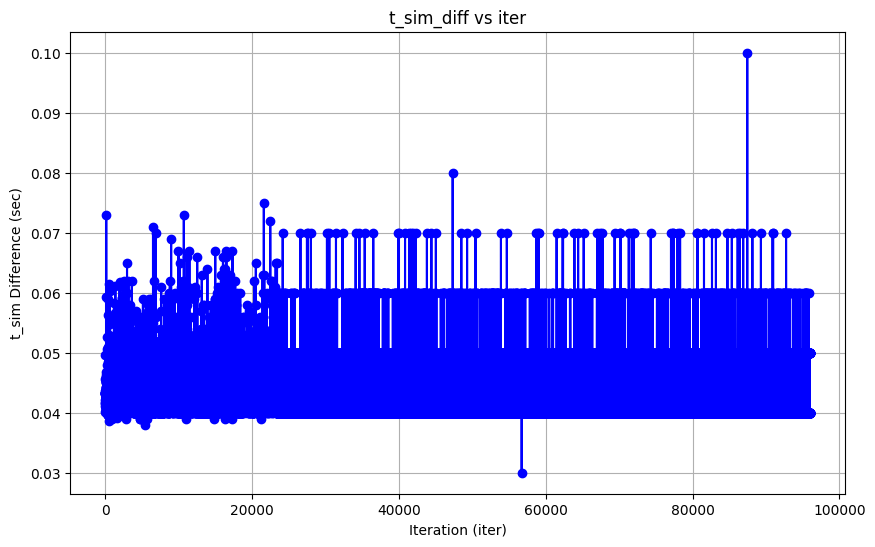

In [180]:
import matplotlib.pyplot as plt

# Plot the graph of t_sim_diff vs iter
if t_sim_diff_list and iter_list:
    # Remove the first iter as there is no corresponding t_sim_diff
    iter_list = iter_list[1:]

    plt.figure(figsize=(10, 6))
    plt.plot(iter_list, t_sim_diff_list, marker='o', linestyle='-', color='b')
    plt.title('t_sim_diff vs iter')
    plt.xlabel('Iteration (iter)')
    plt.ylabel('t_sim Difference (sec)')
    plt.grid(True)
    plt.show()

In [181]:
0.0431823 * 96000

4145.5008

In [517]:
import subprocess
import re
from IPython.display import clear_output, display
import resource

# Set stack size to unlimited (if necessary)
resource.setrlimit(resource.RLIMIT_STACK, (resource.RLIM_INFINITY, resource.RLIM_INFINITY))

# Command to run
command = [
    "../Bonsai-master/runtime/bonsai2_slowdust", 
    "--infile", "templates/plummer_fixed_template_10000000_00000.0000-0", 
    "--snapname", "data/plummer_snap_mpi", 
    "--snapiter", "0", 
    "--eps", "0.001", 
    "--theta", "0.2"
    ,"-T", "10000000" 
    ,"-I", "10" 
]

# Initialize list to store differences between consecutive t_sim values

iter_list = []
de_list = []
dde_list = []

# Regular expressions to capture t_sim and iteration number
t_sim_pattern = re.compile(r't_sim=\s+([\d.eE+-]+)\s+sec')
iter_pattern = re.compile(r'iter=(\d+)')
Etot_pattern = re.compile(r'Etot=\s+([\d.eE+-]+)')
Ekin_pattern = re.compile(r'Ekin=\s+([\d.eE+-]+)')
Epot_pattern = re.compile(r'Epot=\s+([\d.eE+-]+)')
de_pattern = re.compile(r'de=\s+([\d.eE+-]+)')
de_max_pattern = re.compile(r'\(\s+([\d.eE+-]+)\s+\)')
dde_pattern = re.compile(r'd\(de\)=\s+([\d.eE+-]+)')
dde_max_pattern = re.compile(r'\(\s+([\d.eE+-]+)\s+\)')


# Variables to store the previous t_sim and iter values
prev_t_sim = None
prev_iter = -1

# Run the command and capture the output (both stdout and stderr)
output = subprocess.check_output(command, stderr=subprocess.PIPE, text=True)

# Clean up control characters like carriage return
# This will ensure that only the latest instance of any overwritten lines is kept
clean_output = output.replace('\r', '\n')

# Process the cleaned output line by line
for line in clean_output.splitlines():
    # clear_output(wait=True)
    # display(str(line))
    # print(line)

    # Extract iter value
    iter_match = iter_pattern.search(line)
    if iter_match:
        iter = int(iter_match.group(1))
        if iter - prev_iter != 1:
            continue
        iter_list.append(iter)
        prev_iter = iter
        
    # Apply the regex patterns to extract the values
    t_sim_match = t_sim_pattern.search(line)
    if t_sim_match:
        # print(line)

        t_sim = t_sim_pattern.search(line)
        iteration = iter_pattern.search(line)
        Etot = Etot_pattern.search(line)
        Ekin = Ekin_pattern.search(line)
        Epot = Epot_pattern.search(line)
        de = de_pattern.search(line)
        de_max = de_max_pattern.findall(line)[0]  # First occurrence for de_max
        dde = dde_pattern.search(line)
        dde_max = dde_max_pattern.findall(line)[1]  # Second occurrence for dde_max

        # Extracted values
        extracted_values = {
            "t_sim": t_sim.group(1) if t_sim else None,
            "iter": iteration.group(1) if iteration else None,
            "Etot": Etot.group(1) if Etot else None,
            "Ekin": Ekin.group(1) if Ekin else None,
            "Epot": Epot.group(1) if Epot else None,
            "de": de.group(1) if de else None,
            "de_max": de_max if de_max else None,
            "dde": dde.group(1) if dde else None,
            "dde_max": dde_max if dde_max else None
        }
        de_list.append(float(extracted_values["de"]))
        dde_list.append(float(extracted_values["dde"]))



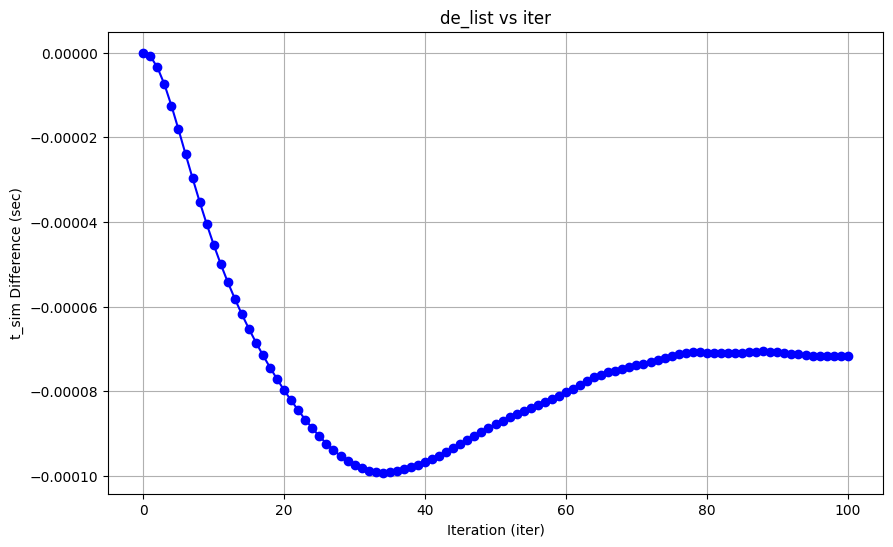

In [514]:
import matplotlib.pyplot as plt
import numpy as np

# Plot the graph of t_sim_diff vs iter
if de_list and iter_list:
    # Remove the first iter as there is no corresponding t_sim_diff
    # iter_list = iter_list[1:]

    plt.figure(figsize=(10, 6))
    plt.plot(iter_list, de_list, marker='o', linestyle='-', color='b')
    plt.title('de_list vs iter')
    plt.xlabel('Iteration (iter)')
    plt.ylabel('t_sim Difference (sec)')
    plt.grid(True)

    plt.show()

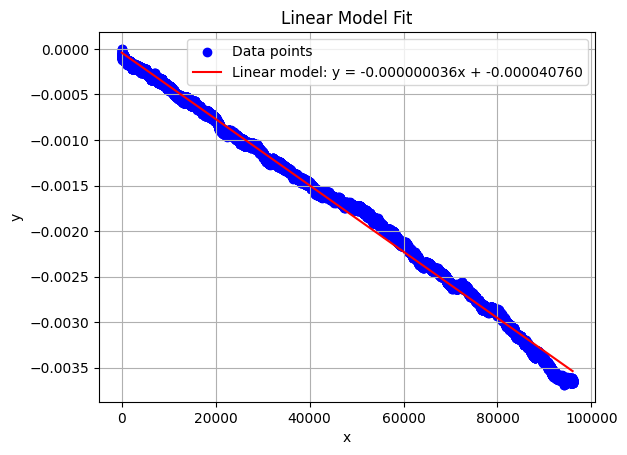

In [510]:

from sklearn.linear_model import LinearRegression
x = np.array(iter_list[:96000]).reshape(-1, 1)  # x values (reshaped to 2D for sklearn)
y = np.array(de_list[:96000])  # y values
model = LinearRegression()
model.fit(x, y)

# Get the slope (m) and intercept (b) of the model
m = model.coef_[0]
b = model.intercept_

# Predict y values for the given x values
y_pred = model.predict(x)

# Plot the data points and the linear model
plt.scatter(x, y, color='blue', label='Data points')
plt.plot(x, y_pred, color='red', label=f'Linear model: y = {m:.9f}x + {b:.9f}')

# Add labels, title, and legend
plt.xlabel('x')
plt.ylabel('y')
plt.title('Linear Model Fit')
plt.legend()
plt.grid(True)

# Display the plot
plt.show()

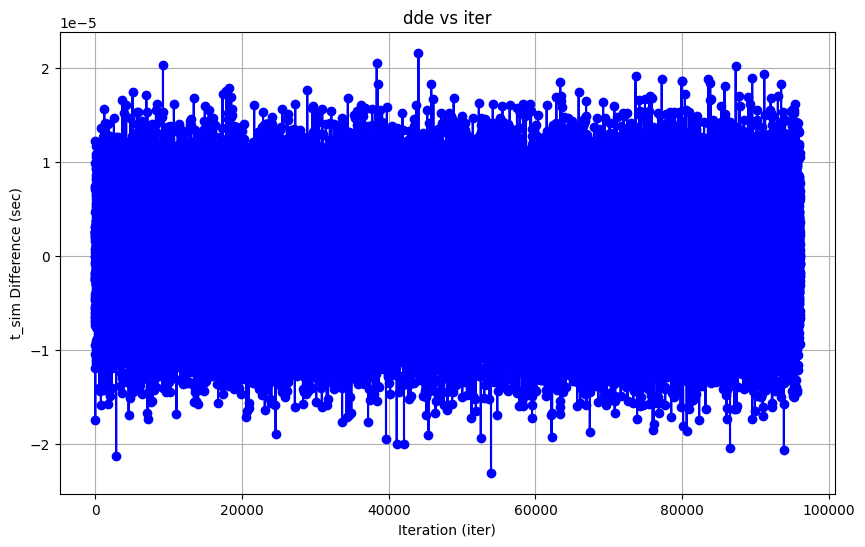

In [378]:
# Plot the graph of t_sim_diff vs iter
if dde_list and iter_list:
    # Remove the first iter as there is no corresponding t_sim_diff
    # iter_list = iter_list[1:]

    plt.figure(figsize=(10, 6))
    plt.plot(iter_list, dde_list, marker='o', linestyle='-', color='b')
    plt.title('dde vs iter')
    plt.xlabel('Iteration (iter)')
    plt.ylabel('t_sim Difference (sec)')
    plt.grid(True)
    plt.show()

In [473]:
dde_abs_list = dde_list[1:]
# print(dde_abs_list)
# [abs(x) for x in dde_list]

if dde_abs_list:

    dde_abs_list_min = min(dde_abs_list)
    dde_abs_list_max = max(dde_abs_list)
    dde_abs_list_avg = sum(dde_abs_list) / len(dde_abs_list)

    print(f"Min t_sim difference: {dde_abs_list_min} sec")
    print(f"Max t_sim difference: {dde_abs_list_max} sec")
    print(f"Average t_sim difference: {dde_abs_list_avg} sec")
else:
    print("No t_sim differences found.")

Min t_sim difference: -2.30982e-05 sec
Max t_sim difference: 2.15808e-05 sec
Average t_sim difference: -3.7953814897873166e-08 sec


In [453]:
vg = (de_list[-1] - de_list[1]) / 96000 

In [462]:
(de_list[960] - de_list[1]) / 960

-1.240746875e-07

In [461]:
vg * 960

-3.6325677e-05

In [428]:
de_list[1000]

-0.000152642

In [443]:
dde_abs_list_avg

-3.795341954975285e-08

In [433]:
de_list[96000] / (96000 * dde_abs_list_avg)

0.9985156484688904

## get from sqlite3

In [190]:
import sqlite3

# Path to your SQLite database file
db_path = 'prof2.nvvp'

# Connect to the database
connection = sqlite3.connect(db_path)

# This allows access to columns by name
connection.row_factory = sqlite3.Row
cursor = connection.cursor()

# Example query
query = "SELECT * FROM CUPTI_ACTIVITY_KIND_DEVICE;"

# Execute the query
cursor.execute(query)

# Fetch the results
rows = cursor.fetchall()

# Convert rows to a list of dictionaries (with column names as keys)
results = [dict(row) for row in rows]
print(results)

# Close the connection
cursor.close()
connection.close()


[{'_id_': 1, 'flags': 1, 'globalMemoryBandwidth': 192192000, 'globalMemorySize': 6360072192, 'constantMemorySize': 65536, 'l2CacheSize': 1572864, 'numThreadsPerWarp': 32, 'coreClockRate': 1771500, 'numMemcpyEngines': 2, 'numMultiprocessors': 10, 'maxIPC': 6, 'maxWarpsPerMultiprocessor': 64, 'maxBlocksPerMultiprocessor': 32, 'maxSharedMemoryPerMultiprocessor': 98304, 'maxRegistersPerMultiprocessor': 65536, 'maxRegistersPerBlock': 65536, 'maxSharedMemoryPerBlock': 49152, 'maxThreadsPerBlock': 1024, 'maxBlockDimX': 1024, 'maxBlockDimY': 1024, 'maxBlockDimZ': 64, 'maxGridDimX': 2147483647, 'maxGridDimY': 65535, 'maxGridDimZ': 65535, 'computeCapabilityMajor': 6, 'computeCapabilityMinor': 1, 'id': 0, 'eccEnabled': 0, 'uuid': b'\x02$\xa5H\xe8\x03\xf9\xe6n\xda\x95\xab\xb7>X%', 'name': 2, 'isCudaVisible': 1}]
